# SPamCo with Ensembles

In [1]:
#Math packages
import numpy as np

#Spamco
from spamco import SPamCo, Validation

#Data packages
from sklearn.datasets import make_moons, make_classification, make_circles, make_blobs, make_gaussian_quantiles
from sklearn.datasets import load_breast_cancer, load_digits
from sklearn.model_selection import train_test_split

#Classifier packages
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
import xgboost as xgb

#Validation packages
from sklearn.metrics import accuracy_score

#Visualization packages
import plotly.express as px

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.pylab as plb
from matplotlib.ticker import MaxNLocator

import baycomp

#General utility packages
from itertools import cycle, islice
import warnings

warnings.filterwarnings("ignore")
matplotlib.rcParams.update({'font.size': 20})

## Utility functions for experiments

### Generate data for toy experiments



#### Simple synthetic  

Generates data for the Binary Classification toy experiment 

Data is generated from two gaussians with separate centers

This is a very simple example that demonstrates the case where SPamCo + Ensembles 

In [ ]:
X,y = make_blobs(n_samples=200, centers=2, cluster_std=0.7, random_state=42)
X[:,0] -= 9.3
X[:,1] -= 2.5

fig = px.scatter(x=X[:,0], y=X[:,1], color=y, template= 'simple_white', color_discrete_map=colors)
fig.update_layout(
    coloraxis_showscale=False,
    xaxis_title='$x^{(1)}$',
    yaxis_title='$x^{(2)}$',
)
fig.update_traces(marker=dict(size=8,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
fig.show()

In [21]:
###Generate data for Binary Classification
def make_2class(random_seed, n):
    np.random.seed(random_seed) 
    X,y = make_blobs(n_samples=200, centers=2, cluster_std=0.7)
    X[:,0] -= 9.3
    X[:,1] -= 2.5

    np.random.seed(1)
    pos_ids = np.where(y == 0)[0]
    neg_ids = np.where(y == 1)[0]
    ids1 = np.random.randint(0,len(pos_ids),5)
    ids2 = np.random.randint(0,len(neg_ids),5)
    p1 = pos_ids[ids1]
    p2 = neg_ids[ids2]

    ## generate labeled and unlabeled data
    l_ids = np.concatenate((p1 , p2))
    u_ids = np.array(list(set(np.arange(X.shape[0])) - set(l_ids)))
    l_data1, l_data2 = X[l_ids,0].reshape(-1,1), X[l_ids,1].reshape(-1,1)
    u_data1, u_data2 = X[u_ids,0].reshape(-1,1), X[u_ids,1].reshape(-1,1)
    labels = y[l_ids]
    return [l_data1, l_data2], [u_data1, u_data2], labels, X, y, [p1, p2]

In [118]:
ldata, udata, llabels, X, y, labels = make_2class(4, 200)

model =  {
    'classifier':RandomForestClassifier(),
    'num_view':1,
    'gamma':0.3,
    'steps':10,
    'regularizer':'hard'
}

base = []
base_clfs = []

for i in range(0, 10):
    clfs, metrics = Validation.validation(
        model_params=model,
        train_data_x=X,
        train_data_y=y,
        percent_labeled=0.05,
        random_seed=np.arange(0,10),
        iters=10
    )
    
    base.append(metrics)
    base_clfs.append(clfs)
    
base_ar = np.array(base)

Validation Iteration: 0 Accuracy: 0.9666666666666667 Labels: 7
Validation Iteration: 0 Accuracy: 0.9666666666666667 Labels: 7
Validation Iteration: 0 Accuracy: 0.9666666666666667 Labels: 7
Validation Iteration: 0 Accuracy: 0.9666666666666667 Labels: 7
Validation Iteration: 0 Accuracy: 0.9666666666666667 Labels: 7
Validation Iteration: 0 Accuracy: 0.75 Labels: 7
Validation Iteration: 0 Accuracy: 0.9666666666666667 Labels: 7
Validation Iteration: 0 Accuracy: 0.9666666666666667 Labels: 7
Validation Iteration: 0 Accuracy: 0.9666666666666667 Labels: 7
Validation Iteration: 0 Accuracy: 0.9666666666666667 Labels: 7


In [27]:
ldata, udata, llabels, X, y, labels = make_2class(4, 200)

model =  {
    'classifier':RandomForestClassifier(),
    'num_view':1,
    'gamma':0.3,
    'steps':50,
    'regularizer':'hard'
}

spamco_metrics = []
spamco_clfs = []

for i in range(0,10):
    clfs, metrics = Validation.validation(
        model_params=model,
        train_data_x=X,
        train_data_y=y,
        percent_labeled=0.05,
        random_seed=np.arange(0,10),
        spaco=True,
        iters=10,
        single_view=True
    )
    #print(f'Iteration: {i} Mean: {np.mean(metrics)}')
    spamco_metrics.append(metrics)
    spamco_clfs.append(clfs)
    
spamco_ar = np.array(spamco_metrics)

Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 0.9833333333333333 Labels: 7
Validation Iteration: 0 Accuracy: 0.9 Labels: 7
Validation Iteration: 0 Accuracy: 0.9833333333333333 Labels: 7
Validation Iteration: 0 Accuracy: 0.95 Labels: 7
Validation Iteration: 0 Accuracy: 0.9833333333333333 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 0.95 Labels: 7
Validation Iteration: 0 Accuracy: 0.95 Labels: 7
Validation Iteration: 0 Accuracy: 0.95 Labels: 7


In [154]:
ldata, udata, llabels, X, y, labels = make_2class(4, 200)

model =  {
    'classifier':RandomForestClassifier(),
    'num_view':2,
    'gamma':0.3,
    'steps':50,
    'regularizer':'hard'
}

spamco_multiview_metrics = []
spamco_multiview_clfs = []

for i in range(0,10):
    clfs, metrics = Validation.validation(
        model_params=model,
        train_data_x=X,
        train_data_y=y,
        percent_labeled=0.05,
        random_seed=np.arange(0,10),
        spaco=True,
        iters=10
    )
    #print(f'Iteration: {i} Mean: {np.mean(metrics)}')
    spamco_multiview_metrics.append(metrics)
    spamco_multiview_clfs.append(clfs)
    
spamco_multiview_ar = np.array(spamco_multiview_metrics)

Validation Iteration: 0 Accuracy: 0.9 Labels: 7
Validation Iteration: 0 Accuracy: 0.9 Labels: 7
Validation Iteration: 0 Accuracy: 0.9 Labels: 7
Validation Iteration: 0 Accuracy: 0.9 Labels: 7
Validation Iteration: 0 Accuracy: 0.9 Labels: 7
Validation Iteration: 0 Accuracy: 0.9 Labels: 7
Validation Iteration: 0 Accuracy: 0.9 Labels: 7
Validation Iteration: 0 Accuracy: 0.9 Labels: 7
Validation Iteration: 0 Accuracy: 0.9 Labels: 7
Validation Iteration: 0 Accuracy: 0.8833333333333333 Labels: 7


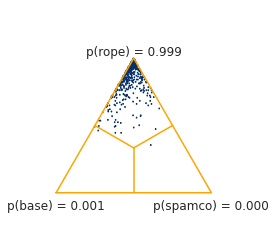

In [35]:
baytest_rope_multi_singleview, bayplot_rope_multi_singleview = baycomp.two_on_multiple(base_ar, spamco_ar, plot=True, rope=0.05, names = ('base','spamco'))

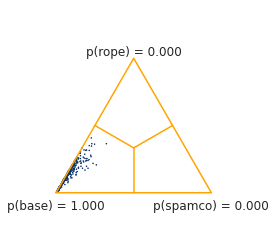

In [159]:
baytest_rope_multi_multiview, bayplot_rope_multi_multiview = baycomp.two_on_multiple(base_ar, spamco_multiview_ar, plot=True, rope=0.05, names = ('base','spamco'))

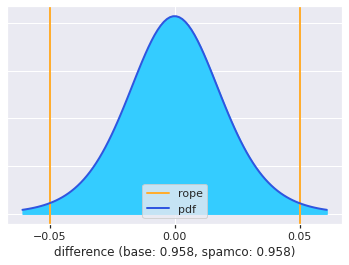

In [156]:
baytest_rope_single_singleview, bayplot_rope_single_singleview = baycomp.two_on_single(np.mean(base_ar, axis=0), np.mean(spamco_ar, axis=0), rope= 0.05, plot=True, names = ('base','spamco'))

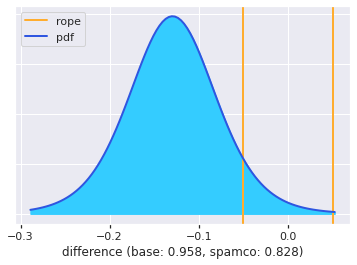

In [157]:
baytest_rope_single_multiview, bayplot_rope_single_multiview = baycomp.two_on_single(np.mean(base_ar, axis=0), np.mean(spamco_multiview_ar, axis=0), rope= 0.05, plot=True, names = ('base','spamco'))

In [42]:
bayplot_rope_multi_singleview.savefig('Two Class Gaussian Single View Simplex.png')
bayplot_rope_single_singleview.savefig('Two Class Gaussian Single View Histogram.png')
bayplot_rope_multi_multiview.savefig('Two Class Gaussian Multi View Simplex.png')
bayplot_rope_single_multiview.savefig('Two Class Gaussian Multi View Histogram.png')

#### Two classifiers on moons synthetic dataset



In [ ]:
X,y = make_moons(n_samples=200, random_state=42, shuffle=True,
    noise=.1)


fig = px.scatter(x=X[:,0], y=X[:,1], color=y, template= 'simple_white', color_discrete_map=colors)
fig.update_layout(
    coloraxis_showscale=False,
    xaxis_title='$x^{(1)}$',
    yaxis_title='$x^{(2)}$',
)
fig.update_traces(marker=dict(size=8,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
fig.show()

In [115]:
X,y = make_moons(n_samples=200, random_state=42, shuffle=True,
    noise=.1)


model =  {
    'classifier':RandomForestClassifier(),
    'num_view':1,
    'gamma':0.3,
    'steps':10,
    'regularizer':'hard'
}

base_moon = []
base_clfs_moon = []

for i in range(0, 10):
    clfs, metrics = Validation.validation(
        model_params=model,
        train_data_x=X,
        train_data_y=y,
        percent_labeled=0.05,
        random_seed=np.arange(0,10),
        iters=10
    )
    
    base_moon.append(metrics)
    base_clfs_moon.append(clfs)
    
base_ar_moon = np.array(base_moon)

Validation Iteration: 0 Accuracy: 0.9166666666666666 Labels: 7
Validation Iteration: 0 Accuracy: 0.9166666666666666 Labels: 7
Validation Iteration: 0 Accuracy: 0.9166666666666666 Labels: 7
Validation Iteration: 0 Accuracy: 0.95 Labels: 7
Validation Iteration: 0 Accuracy: 0.9333333333333333 Labels: 7
Validation Iteration: 0 Accuracy: 0.9333333333333333 Labels: 7
Validation Iteration: 0 Accuracy: 0.9333333333333333 Labels: 7
Validation Iteration: 0 Accuracy: 0.9333333333333333 Labels: 7
Validation Iteration: 0 Accuracy: 0.9333333333333333 Labels: 7
Validation Iteration: 0 Accuracy: 0.9166666666666666 Labels: 7


In [170]:
X,y = make_moons(n_samples=200, random_state=42, shuffle=True,
    noise=.1)


model =  {
    'classifier':RandomForestClassifier(),
    'num_view':1,
    'gamma':0.3,
    'steps':50,
    'regularizer':'hard'
}

spamco_metrics_moon = []
spamco_clfs_moon = []

for i in range(0,10):
    clfs, metrics = Validation.validation(
        model_params=model,
        train_data_x=X,
        train_data_y=y,
        percent_labeled=0.05,
        random_seed=np.arange(0,10),
        spaco=True,
        iters=10,
        single_view=True
    )
    #print(f'Iteration: {i} Mean: {np.mean(metrics)}')
    spamco_metrics_moon.append(metrics)
    spamco_clfs_moon.append(clfs)
    
spamco_ar_moon = np.array(spamco_metrics_moon)

Validation Iteration: 0 Accuracy: 0.9166666666666666 Labels: 7
Validation Iteration: 0 Accuracy: 0.9166666666666666 Labels: 7
Validation Iteration: 0 Accuracy: 0.9166666666666666 Labels: 7
Validation Iteration: 0 Accuracy: 0.9166666666666666 Labels: 7
Validation Iteration: 0 Accuracy: 0.9166666666666666 Labels: 7
Validation Iteration: 0 Accuracy: 0.9166666666666666 Labels: 7
Validation Iteration: 0 Accuracy: 0.9166666666666666 Labels: 7
Validation Iteration: 0 Accuracy: 0.9166666666666666 Labels: 7
Validation Iteration: 0 Accuracy: 0.9166666666666666 Labels: 7
Validation Iteration: 0 Accuracy: 0.9166666666666666 Labels: 7


In [161]:
X,y = make_moons(n_samples=200, random_state=42, shuffle=True, noise=.1)


model =  {
    'classifier':RandomForestClassifier(class_weight='balanced'),
    'num_view':2,
    'gamma':0.3,
    'steps':50,
    'regularizer':'hard'
}

spamco_multiview_metrics_moon = []
spamco_multiview_clfs_moon = []

for i in range(0,10):
    clfs, metrics = Validation.validation(
        model_params=model,
        train_data_x=X,
        train_data_y=y,
        percent_labeled=0.1,
        random_seed=np.arange(0,10),
        spaco=True,
        iters=10
    )
    #print(f'Iteration: {i} Mean: {np.mean(metrics)}')
    spamco_multiview_metrics_moon.append(metrics)
    spamco_multiview_clfs_moon.append(clfs)
    
spamco_multiview_ar_moon = np.array(spamco_multiview_metrics_moon)

Validation Iteration: 0 Accuracy: 0.5833333333333334 Labels: 14
Validation Iteration: 0 Accuracy: 0.5833333333333334 Labels: 14
Validation Iteration: 0 Accuracy: 0.5833333333333334 Labels: 14
Validation Iteration: 0 Accuracy: 0.5833333333333334 Labels: 14
Validation Iteration: 0 Accuracy: 0.5666666666666667 Labels: 14
Validation Iteration: 0 Accuracy: 0.5666666666666667 Labels: 14
Validation Iteration: 0 Accuracy: 0.5833333333333334 Labels: 14
Validation Iteration: 0 Accuracy: 0.6 Labels: 14
Validation Iteration: 0 Accuracy: 0.5666666666666667 Labels: 14
Validation Iteration: 0 Accuracy: 0.5666666666666667 Labels: 14


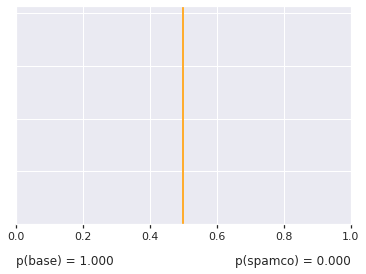

In [126]:
baytest_rope_multi_multiview, bayplot_rope_multi_multiview = baycomp.two_on_multiple(base_ar_moon, spamco_multiview_ar_moon, plot=True, names = ('base','spamco'))

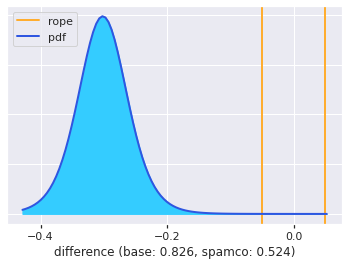

In [127]:
baytest_rope_single_multiview, bayplot_rope_single_multiview = baycomp.two_on_single(np.mean(base_ar_moon, axis=0), np.mean(spamco_multiview_ar_moon, axis=0), rope= 0.05, plot=True, names = ('base','spamco'))

#### Two classifiers on four class synthetic datasets complete separation

In [ ]:
X,y = make_blobs(n_samples=200, centers=4, cluster_std=0.5, random_state=3)


fig = px.scatter(x=X[:,0], y=X[:,1], color=y, template= 'simple_white', color_discrete_map=colors)
fig.update_layout(
    coloraxis_showscale=False,
    xaxis_title='$x^{(1)}$',
    yaxis_title='$x^{(2)}$',
)
fig.update_traces(marker=dict(size=8,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
fig.show()

In [141]:
X,y = make_blobs(n_samples=200, centers=4, cluster_std=0.5, random_state=3)

model =  {
    'classifier':RandomForestClassifier(),
    'num_view':1,
    'gamma':0.3,
    'steps':10,
    'regularizer':'hard'
}

base_4blob = []
base_clfs_4blob = []

for i in range(0, 10):
    clfs, metrics = Validation.validation(
        model_params=model,
        train_data_x=X,
        train_data_y=y,
        percent_labeled=0.05,
        random_seed=np.arange(0,10),
        iters=10
    )
    
    base_4blob.append(metrics)
    base_clfs_4blob.append(clfs)
    
base_ar_4blob = np.array(base_4blob)

Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7


In [142]:
X,y = make_blobs(n_samples=200, centers=4, cluster_std=0.5, random_state=3)

model =  {
    'classifier':RandomForestClassifier(),
    'num_view':1,
    'gamma':0.3,
    'steps':50,
    'regularizer':'hard'
}

spamco_metrics_4blob_single = []
spamco_clfs_4blob_single = []

for i in range(0,10):
    clfs, metrics = Validation.validation(
        model_params=model,
        train_data_x=X,
        train_data_y=y,
        percent_labeled=0.05,
        random_seed=np.arange(0,10),
        spaco=True,
        iters=10,
        single_view=True
    )
    #print(f'Iteration: {i} Mean: {np.mean(metrics)}')
    spamco_metrics_4blob_single.append(metrics)
    spamco_clfs_4blob_single.append(clfs)
    
spamco_ar_4blob_single = np.array(spamco_metrics_4blob_single)

Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7


In [143]:
X,y = make_blobs(n_samples=200, centers=4, cluster_std=0.5, random_state=3)

model =  {
    'classifier':RandomForestClassifier(),
    'num_view':1,
    'gamma':0.3,
    'steps':50,
    'regularizer':'hard'
}

spamco_multiview_metrics_4blob_mulit = []
spamco_multiview_clfs_4blob_mulit = []

for i in range(0,10):
    clfs, metrics = Validation.validation(
        model_params=model,
        train_data_x=X,
        train_data_y=y,
        percent_labeled=0.05,
        random_seed=np.arange(0,10),
        spaco=True,
        iters=10
    )
    #print(f'Iteration: {i} Mean: {np.mean(metrics)}')
    spamco_multiview_metrics_4blob_mulit.append(metrics)
    spamco_multiview_clfs_4blob_mulit.append(clfs)
    
spamco_multiview_ar_4blob_mulit = np.array(spamco_multiview_metrics_4blob_mulit)

Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7
Validation Iteration: 0 Accuracy: 1.0 Labels: 7


#### Multiple random toy datasets

In [178]:

model =  {
    'classifier':RandomForestClassifier(),
    'num_view':i,
    'gamma':0.3,
    'steps':10,
    'regularizer':'hard'
}

base_mix = []
base_clfs_mix = []

for i in range(2, 12):
    X, y = make_classification(n_samples = 200, n_features=i, n_redundant=0, n_informative=i, random_state=i, n_clusters_per_class=1)
    model =  {
        'classifier':RandomForestClassifier(),
        'num_view':1,
        'gamma':0.3,
        'steps':10,
        'regularizer':'hard'
    }
    
    clfs, metrics = Validation.validation(
        model_params=model,
        train_data_x=X,
        train_data_y=y,
        percent_labeled=0.05,
        random_seed=np.arange(0,10),
        iters=10,
        verbosity=10000
    )
    
    base_mix.append(metrics)
    base_clfs_mix.append(clfs)
    
base_ar_mix = np.array(base_mix)

Validation Iteration: 0 Accuracy: 0.7 Labels: 7
Validation Iteration: 0 Accuracy: 0.6333333333333333 Labels: 7
Validation Iteration: 0 Accuracy: 0.75 Labels: 7
Validation Iteration: 0 Accuracy: 0.8833333333333333 Labels: 7
Validation Iteration: 0 Accuracy: 0.8166666666666667 Labels: 7
Validation Iteration: 0 Accuracy: 0.6833333333333333 Labels: 7
Validation Iteration: 0 Accuracy: 0.55 Labels: 7
Validation Iteration: 0 Accuracy: 0.5333333333333333 Labels: 7
Validation Iteration: 0 Accuracy: 0.6333333333333333 Labels: 7
Validation Iteration: 0 Accuracy: 0.65 Labels: 7


In [179]:
spamco_mix = []
spamco_clfs_mix = []

for i in range(2, 12):
    X, y = make_classification(n_samples = 200, n_features=i, n_redundant=0, n_informative=i, random_state=i, n_clusters_per_class=1)
    
    model =  {
        'classifier':RandomForestClassifier(),
        'num_view':i,
        'gamma':0.3,
        'steps':10,
        'regularizer':'hard'
    }

    clfs, metrics = Validation.validation(
        model_params=model,
        train_data_x=X,
        train_data_y=y,
        percent_labeled=0.05,
        random_seed=np.arange(0,20),
        iters=20,
        verbosity=10000
    )
    
    spamco_mix.append(metrics)
    spamco_clfs_mix.append(clfs)
    
spamco_ar_mix = np.array(spamco_mix)

Validation Iteration: 0 Accuracy: 0.7833333333333333 Labels: 7
Validation Iteration: 0 Accuracy: 0.6666666666666666 Labels: 7
Validation Iteration: 0 Accuracy: 0.7166666666666667 Labels: 7
Validation Iteration: 0 Accuracy: 0.9166666666666666 Labels: 7
Validation Iteration: 0 Accuracy: 0.8 Labels: 7
Validation Iteration: 0 Accuracy: 0.6833333333333333 Labels: 7
Validation Iteration: 0 Accuracy: 0.5666666666666667 Labels: 7
Validation Iteration: 0 Accuracy: 0.5666666666666667 Labels: 7
Validation Iteration: 0 Accuracy: 0.6666666666666666 Labels: 7
Validation Iteration: 0 Accuracy: 0.6666666666666666 Labels: 7


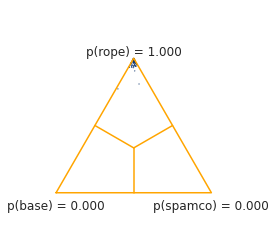

In [180]:
baytest_rope_mix_multiview, bayplot_rope_mix_multiview = baycomp.two_on_multiple(
    base_ar_mix, spamco_ar_mix, plot=True, rope=0.05, names = ('base','spamco'))

## AdaBoost Classifier Testing

In [192]:
data = load_breast_cancer()
X, y = data.data, data.target

model =  {
    'classifier':AdaBoostClassifier(),
    'num_view':1,
    'gamma':0.3,
    'steps':10,
    'regularizer':'hard'
}

adaboost_base_metrics = []
adaboost_base_clfs = []

for i in range(0, 10):
    clfs, metrics = Validation.validation(
        model_params=model,
        train_data_x=X,
        train_data_y=y,
        percent_labeled=0.05,
        random_seed=np.arange(0,10),
        iters=10
    )
    
    adaboost_base_metrics.append(metrics)
    adaboost_base_clfs.append(clfs)
    
adaboost_base_score = np.array(adaboost_base_metrics)

Validation Iteration: 0 Accuracy: 0.8830409356725146 Labels: 19
Validation Iteration: 0 Accuracy: 0.9005847953216374 Labels: 19
Validation Iteration: 0 Accuracy: 0.8947368421052632 Labels: 19
Validation Iteration: 0 Accuracy: 0.8654970760233918 Labels: 19
Validation Iteration: 0 Accuracy: 0.8830409356725146 Labels: 19
Validation Iteration: 0 Accuracy: 0.8713450292397661 Labels: 19
Validation Iteration: 0 Accuracy: 0.8654970760233918 Labels: 19
Validation Iteration: 0 Accuracy: 0.9005847953216374 Labels: 19
Validation Iteration: 0 Accuracy: 0.9005847953216374 Labels: 19
Validation Iteration: 0 Accuracy: 0.8654970760233918 Labels: 19


In [3]:
data = load_breast_cancer()
X, y = data.data, data.target

model =  {
    'classifier':AdaBoostClassifier(),
    'num_view':2,
    'gamma':0.3,
    'steps':2000,
    'regularizer':'hard'
}

adaboost_single_metrics = []
adaboost_single_clfs = []

for i in range(0, 10):
    clfs, metrics = Validation.validation(
        model_params=model,
        train_data_x=X,
        train_data_y=y,
        percent_labeled=0.05,
        random_seed=np.arange(0,10),
        spaco=True,
        single_view=True,
        iters=10
    )
    
    adaboost_single_metrics.append(metrics)
    adaboost_single_clfs.append(clfs)
    
adaboost_single_score = np.array(adaboost_single_metrics)

Validation Iteration: 0 Accuracy: 0.8771929824561403 Labels: 19
Validation Iteration: 0 Accuracy: 0.8947368421052632 Labels: 19
Validation Iteration: 0 Accuracy: 0.8771929824561403 Labels: 19
Validation Iteration: 0 Accuracy: 0.8947368421052632 Labels: 19
Validation Iteration: 0 Accuracy: 0.8947368421052632 Labels: 19
Validation Iteration: 0 Accuracy: 0.8830409356725146 Labels: 19
Validation Iteration: 0 Accuracy: 0.8771929824561403 Labels: 19
Validation Iteration: 0 Accuracy: 0.8830409356725146 Labels: 19
Validation Iteration: 0 Accuracy: 0.8947368421052632 Labels: 19
Validation Iteration: 0 Accuracy: 0.8947368421052632 Labels: 19


In [2]:
data = load_breast_cancer()
X, y = data.data, data.target

model =  {
    'classifier':AdaBoostClassifier(),
    'num_view':X.shape[1],
    'gamma':0.3,
    'steps':2000,
    'regularizer':'hard'
}

adaboost_multi_metrics = []
adaboost_multi_clfs = []

for i in range(0, 10):
    clfs, metrics = Validation.validation(
        model_params=model,
        train_data_x=X,
        train_data_y=y,
        percent_labeled=0.05,
        random_seed=np.arange(0,10),
        spaco=True,
        iters=10
    )
    
    adaboost_multi_metrics.append(metrics)
    adaboost_multi_clfs.append(clfs)
    
adaboost_multi_score = np.array(adaboost_multi_metrics)

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61

[0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],


[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],


[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61

[0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],


[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],


[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61

[0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],


[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],


[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61

[0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],


[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],


[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61

[0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],


[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],


[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61

[0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],


[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],


[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61

[0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],


[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],


[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61

[0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],


[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],


[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61

[0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],


[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],


[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61856929],
       [0.38143071, 0.61

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60739513],
       [0.39260487, 0.60

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61993862],
       [0.38006138, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36785186],
       [0.63214814, 0.36

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61613133],
       [0.38386867, 0.61

[0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],
       [0.6230465, 0.3769535],


[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],
       [0.6157226, 0.3842774],


[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61766787],
       [0.38233213, 0.61

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0] [array([[0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38983616],
       [0.61016384, 0.38

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1] [array([[0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62463042],
       [0.37536958, 0.62

In [190]:
data = load_breast_cancer()
X, y = data.data, data.target

x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.95, stratify=y, random_state=42)
rfc = RandomForestClassifier()
rfc.fit(x_train, y_train)

rfc_pred = rfc.predict(x_test)

print(f'RFC accuracy with {len(x_train)} labeled data {accuracy_score(rfc_pred, y_test)}')

RFC accuracy with 28 labeled data 0.9408502772643254


In [189]:
data = load_breast_cancer()
X, y = data.data, data.target

x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.95, stratify=y, random_state=42)
afc = AdaBoostClassifier()
afc.fit(x_train, y_train)

afc_pred = afc.predict(x_test)

print(f'AFC accuracy with {len(x_train)} labeled data {accuracy_score(afc_pred, y_test)}')

AFC accuracy with 28 labeled data 0.878003696857671


In [188]:
data = load_breast_cancer()
X, y = data.data, data.target

x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.95, stratify=y, random_state=42)
xfc = xgb.XGBClassifier(silent=True, verbosity=0)
xfc.fit(x_train, y_train)

xfc_pred = xfc.predict(x_test)

print(f'XFC accuracy with {len(x_train)} labeled data {accuracy_score(xfc_pred, y_test)}')

XFC accuracy with 28 labeled data 0.878003696857671


In [187]:
data = load_digits()
X, y = data.data, data.target

x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.95, stratify=y, random_state=42)
rfc = RandomForestClassifier()
rfc.fit(x_train, y_train)

rfc_pred = rfc.predict(x_test)

print(f'RFC accuracy with {len(x_train)} labeled data {accuracy_score(rfc_pred, y_test)}')

RFC accuracy with 89 labeled data 0.8624121779859485


In [186]:
data = load_digits()
X, y = data.data, data.target

x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.95, stratify=y, random_state=42)
afc = AdaBoostClassifier()
afc.fit(x_train, y_train)

afc_pred = afc.predict(x_test)

print(f'AFC accuracy with {len(x_train)} labeled data {accuracy_score(afc_pred, y_test)}')

AFC accuracy with 89 labeled data 0.1358313817330211


In [184]:
data = load_digits()
X, y = data.data, data.target

x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.95, stratify=y, random_state=42)

ldata = []
udata = []
for i in range(x_train.shape[1]):
    ldata.append(x_train[:,i].reshape(-1,1))
    udata.append(x_test[:,i].reshape(-1,1))

#### spaco experiment gamma=0.3
spaco = SPamCo(
    labeled_data=ldata,
    unlabeled_data=udata,
    labels=y_train,
    num_view=x_train.shape[1],
    gamma=0.3,
    iterations=2000
)

spaco.fit(AdaBoostClassifier())
clfs = spaco.get_classifiers()

score = 0
for i in range(len(clfs)):
    score += clfs[i].predict_proba(X[:,i].reshape(-1,1))

pred_y = np.argmax(score, axis = 1)

print(f'AFC accuracy with {len(x_train)} labeled data {accuracy_score(pred_y, y)}')



AFC accuracy with 89 labeled data 0.09849749582637729


In [191]:
data = load_digits()
X, y = data.data, data.target

x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.95, stratify=y, random_state=42)

ldata = []
udata = []
for i in range(2):
    ldata.append(x_train)
    udata.append(x_test)

#### spaco experiment2 gamma=0.3
spaco = SPamCo(
    labeled_data=ldata,
    unlabeled_data=udata,
    labels=y_train,
    num_view=2,
    gamma=0.3,
    iterations=200
)

spaco.fit(AdaBoostClassifier())
clfs = spaco.get_classifiers()

score = 0
for i in range(len(clfs)):
    score += clfs[i].predict_proba(x_test)

pred_y = np.argmax(score, axis = 1)

print(f'FC accuracy with {len(x_train)} labeled data {accuracy_score(pred_y, y_test)}')



XFC accuracy with 89 labeled data 0.20725995316159251


In [185]:
data = load_digits()
X, y = data.data, data.target

x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.95, stratify=y, random_state=42)
xfc = xgb.XGBClassifier(silent=True, verbosity=0)
xfc.fit(x_train, y_train)

xfc_pred = xfc.predict(x_test)

print(f'XFC accuracy with {len(x_train)} labeled data {accuracy_score(xfc_pred, y_test)}')

XFC accuracy with 89 labeled data 0.7769320843091335


In [3]:
data = load_digits()
X, y = data.data, data.target

model =  {
    'classifier':xgb.XGBClassifier(silent=True, verbosity=0),
    'num_view':2,
    'gamma':0.3,
    'steps':2000,
    'regularizer':'hard'
}

xfc_2_metrics = []
xfc_2_clfs = []

for i in range(0, 10):
    clfs, metrics = Validation.validation(
        model_params=model,
        train_data_x=X,
        train_data_y=y,
        percent_labeled=0.05,
        random_seed=np.arange(0,10),
        spaco=True,
        iters=10,
        hsplit=True,
        hsplit_size = 2
    )
    
    xfc_2_metrics.append(metrics)
    xfc_2_clfs.append(clfs)
    
xfc_2_score = np.array(xfc_2_metrics)

Validation Iteration: 0 Accuracy: 0.6407407407407407 Labels: 62


KeyboardInterrupt: 

In [76]:
data = load_digits()
X, y = data.data, data.target

x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.95, stratify=y, random_state=42)

ldata = []
udata = []
for i in range(x_train.shape[1]):
    ldata.append(x_train[:,i].reshape(-1,1))
    udata.append(x_test[:,i].reshape(-1,1))

#### spaco experiment gamma=0.3
spaco = SPamCo(
    labeled_data=ldata,
    unlabeled_data=udata,
    labels=y_train,
    num_view=x_train.shape[1],
    gamma=0.3,
    iterations=2000
)

spaco.fit(xgb.XGBClassifier(silent=True, verbosity=0))
clfs = spaco.get_classifiers()

predictions = []
for i in range(len(clfs)):
    pred = clfs[i].predict_proba(X[:,i].reshape(-1,1))
    predictions.append(pred)

pred_y = np.argmax(sum(predictions), axis = 1)

print(f'XFC accuracy with {len(x_train)} labeled data {accuracy_score(pred_y, y)}')



XFC accuracy with 1437 labeled data 0.11630495269894268


In [90]:
data = load_digits()
X, y = data.data, data.target

x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.95, stratify=y, random_state=42)

x_split = np.hsplit(X, 2)

ldata = np.hsplit(x_train, 2)
udata = np.hsplit(x_test, 2)

#### spaco experiment gamma=0.3
spaco = SPamCo(
    labeled_data=ldata,
    unlabeled_data=udata,
    labels=y_train,
    num_view=2,
    gamma=0.3,
    iterations=2000
)

spaco.fit(xgb.XGBClassifier(silent=True, verbosity=0))
clfs = spaco.get_classifiers()

predictions = []
for i in range(len(clfs)):
    pred = clfs[i].predict_proba(x_split[i])
    predictions.append(pred)

pred_y = np.argmax(sum(predictions), axis = 1)

print(f'XFC accuracy with {len(x_train)} labeled data {accuracy_score(pred_y, y)}')



XFC accuracy with 89 labeled data 0.8174735670562048


In [87]:
np.hsplit(X, 2)[1].shape

(1797, 32)

In [74]:
X[:,2].shape

(1797,)

In [27]:
clfs[2].predict_proba(X[:,2].reshape(-1,1)) + clfs[1].predict_proba(X[:,1].reshape(-1,1)) 

array([[0.12236608, 0.12215101, 0.8226053 , ..., 0.127807  , 0.05500257,
        0.09958486],
       [0.24087438, 0.24191186, 0.14693536, ..., 0.24315356, 0.09876056,
        0.19510952],
       [0.24087438, 0.24191186, 0.14693536, ..., 0.24315356, 0.09876056,
        0.19510952],
       ...,
       [0.14486752, 0.12382818, 0.59271985, ..., 0.12514092, 0.08281865,
        0.20133568],
       [0.12172615, 0.12175453, 0.5067002 , ..., 0.12270049, 0.05493263,
        0.10330012],
       [0.1251739 , 0.3985222 , 0.43080115, ..., 0.13012044, 0.05694598,
        0.400818  ]], dtype=float32)

In [14]:
pred_y

array([2, 2, 2, ..., 2, 2, 2], dtype=int64)

In [10]:
data = load_digits()
X, y = data.data, data.target

x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.95, stratify=y, random_state=42)

ldata = []
udata = []
for i in range(2):
    ldata.append(x_train)
    udata.append(x_test)

#### spaco experiment2 gamma=0.3
spaco = SPamCo(
    labeled_data=ldata,
    unlabeled_data=udata,
    labels=y_train,
    num_view=2,
    gamma=0.3,
    iterations=200
)

spaco.fit(xgb.XGBClassifier(silent=True, verbosity=0))
clfs = spaco.get_classifiers()

score = clfs[0].predict_proba(x_test)

pred_y = np.argmax(score, axis = 1)

print(f'XFC accuracy with {len(x_train)} labeled data {accuracy_score(pred_y, y_test)}')



XFC accuracy with 89 labeled data 0.781615925058548
